# KORNIA: fast tutorial

Kornia - это Open Source библиотека алгоритмов компьютерного зрения на языке Python. Она сочетает в себе как классические алгоритмы компьютерного зрения, так и алгоритмы глубинного зрения и графики, в которых используется фреймворк Pytorch и его Autograd-based функции для повышения эффективности.

![img](https://github.com/kornia/data/raw/main/kornia_banner_pixie.png)


Установить эту библиотеку очень просто, в одну строчку:

In [293]:
%%capture
!pip install kornia

Ниже рассмотрим различные применения этого фреймворка.

## 1. Загрузка изображений в Kornia

In [294]:
import cv2
from matplotlib import pyplot as plt
import numpy as np

import torch
import torchvision
import kornia as K

from tqdm.notebook import tqdm

Скачаем изображение:

In [295]:
%%capture
!wget https://w-dog.ru/wallpapers/7/1/304234767420579/simpsony-krazha-mult.jpg -O test_image.jpg

In [296]:
# по умолчанию OpenCV загрузит изображение в формате BGR
bgr_image = cv2.imread('test_image.jpg')

# преобразуем в RGB-формат
rgb_image = cv2.cvtColor(bgr_image, cv2.COLOR_BGR2RGB)

print(bgr_image.shape, type(bgr_image))

(1200, 1920, 3) <class 'numpy.ndarray'>


Изобразим картинки:

In [297]:
def show_images(first_image, second_image, first_label, second_label):
    fig, axs = plt.subplots(1, 2, figsize=(32, 16))
    axs = axs.ravel()

    axs[0].axis('off')
    axs[0].set_title(first_label, fontsize=24)
    axs[0].imshow(first_image)

    axs[1].axis('off')
    axs[1].set_title(second_label, fontsize=24)
    axs[1].imshow(second_image)

    plt.show()

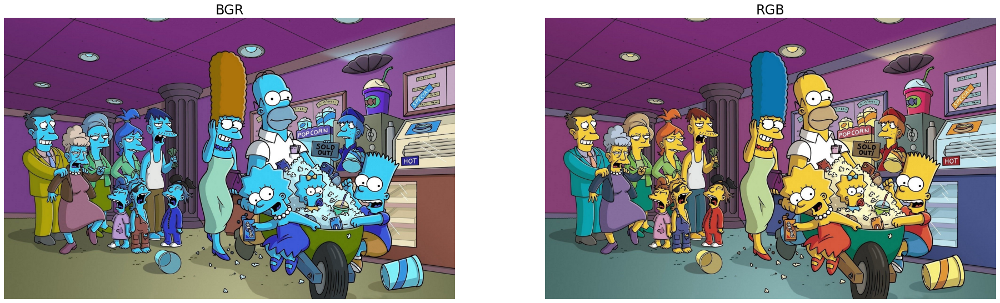

In [298]:
show_images(bgr_image, rgb_image, 'BGR', 'RGB')

А как Kornia работает с изображениями:

In [299]:
bgr_tensor = K.image_to_tensor(bgr_image)
print(type(bgr_tensor))
print(f'from {bgr_image.shape} to {bgr_tensor.shape}') # H x W x C -> C x H x W

<class 'torch.Tensor'>
from (1200, 1920, 3) to torch.Size([3, 1200, 1920])


Мы видим, что `kornia.image_to_tensor` преобразует изображение в тензор, и переставляет размерности так, чтобы каналы шли на первом месте (в отличие от `torch.tensor`, который не переставляет размерности).

Заметим, что с помощью kornia мы тоже можем преобразовать BGR в RGB:

In [300]:
rgb_tensor = K.color.bgr_to_rgb(bgr_tensor)

Аналогично, с помощью kornia можно преобразовывать тензоры в изображения, и каналы автоматически будут переставлены:

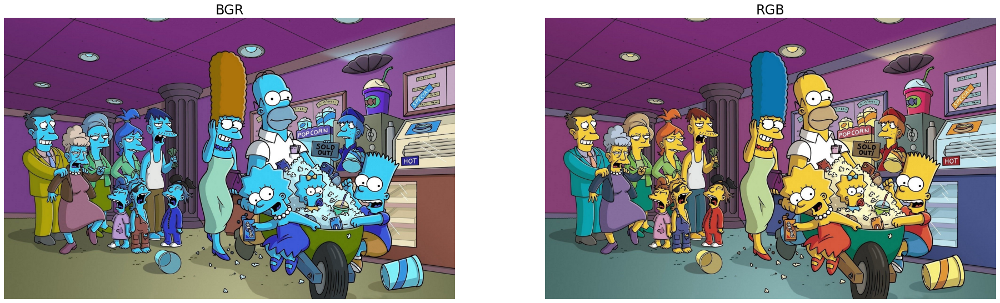

In [301]:
show_images(K.tensor_to_image(bgr_tensor), K.tensor_to_image(rgb_tensor), 'BGR', 'RGB')

## 2. Преобразования изображений

In [302]:
def show_image_grid(input):
    '''
    Функция для отрисовки сетки изображений
    '''
    out = torchvision.utils.make_grid(input, nrow=2, padding=5)
    out = K.utils.tensor_to_image(out)
    plt.imshow(out)
    plt.axis('off')
    plt.show()

In [303]:
images = rgb_tensor.expand(4, -1, -1, -1)  # создадим  4 изображения
images = images.float() / 255.0

Посмотрим на 4 одинаковых (уже знакомых нам) изображения и на то, что с ними можно сделать:

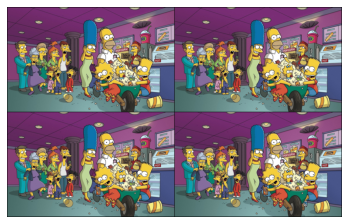

In [304]:
show_image_grid(
    images
)

Можно изменить контрастность:

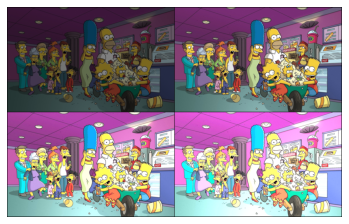

In [305]:
show_image_grid(
    K.enhance.adjust_contrast(images, torch.linspace(0.5, 2, 4))
)

Посмотрим, как можно изменять яркость:

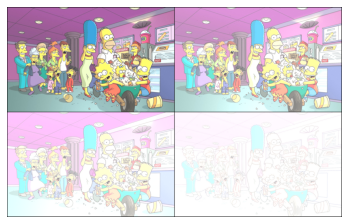

In [306]:
show_image_grid(
    K.enhance.adjust_brightness(images, torch.linspace(0.2, 0.8, 4))
)

Изменим оттенок изображения (путем преобрахования в HSV-формат и цикл. изменения в канале H):

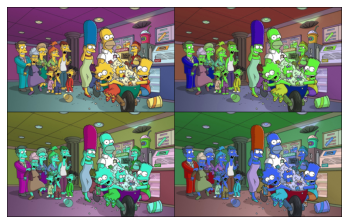

In [307]:
show_image_grid(
    K.enhance.adjust_hue(images, torch.linspace(0, np.pi, 4))
)

Вспомним, что похожие преобразования мы видели в `torchvision.transforms.ColorJitter`... Многие использовали эту функцию для аугментации изображений в процессе препроцессинга данных при решении различных задач компьютерного зрения.

Исходя из этого, далее посмотрим какие аугментации поддерживает Kornia...

## 3. Аугментация изображений

В этой секции посмотрим на несколько аугментаций:

Сначала посмотрим на `RandomPlanckianJitter`:

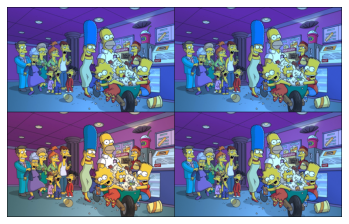

In [308]:
aug = K.augmentation.RandomPlanckianJitter("blackbody", same_on_batch=False, p=1.0)
show_image_grid(aug(images))

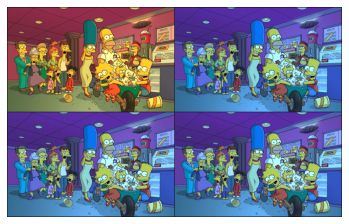

In [309]:
aug = K.augmentation.RandomPlanckianJitter("CIED", same_on_batch=False, p=1.0)
show_image_grid(aug(images))

Посмотрим на `RandomChannelShuffle`:

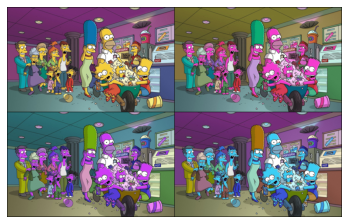

In [310]:
aug = K.augmentation.RandomChannelShuffle(same_on_batch=False, keepdim=False, p=1.0)
show_image_grid(aug(images))

Есть и стандартные аугментации, которые позволяют "вырезать" из всего изображения некоторую часть разными способами:

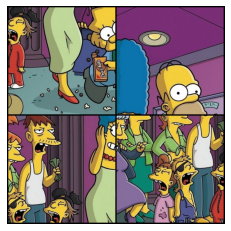

In [311]:
aug = K.augmentation.RandomCrop((400, 400), resample="nearest", cropping_mode="resample", 
                 align_corners=True, p=0.9)

show_image_grid(aug(images))

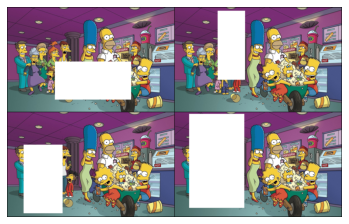

In [312]:
aug = K.augmentation.RandomErasing(scale=(0.02, 0.33), ratio=(0.3, 3.3), value=1, 
                    same_on_batch=False, keepdim=False, p=1.0)

show_image_grid(aug(images))

In [313]:
from kornia.augmentation import AugmentationSequential

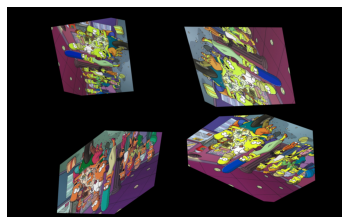

In [314]:
aug_list = AugmentationSequential(
    K.augmentation.ColorJitter(0.1, 0.1, 0.1, 0.1, p=1.0),
    K.augmentation.RandomAffine(180, [0.1, 0.1], [0.7, 1.2], [30., 50.], p=1.0),
    K.augmentation.RandomPerspective(0.5, p=1.0),
    same_on_batch=False,
)

show_image_grid(aug_list(images))

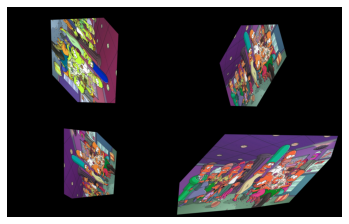

In [315]:
show_image_grid(aug_list(images))

## 4. Лоссы в Kornia: пример про денойзинг изображений

Кроме аугментаций для задач различного типа (классификация, детекция) в Kornia реализованы различные лоссы. В этой секции рассмотрим алгоритм денойсинга изображений с помощью TotalVariation-ло

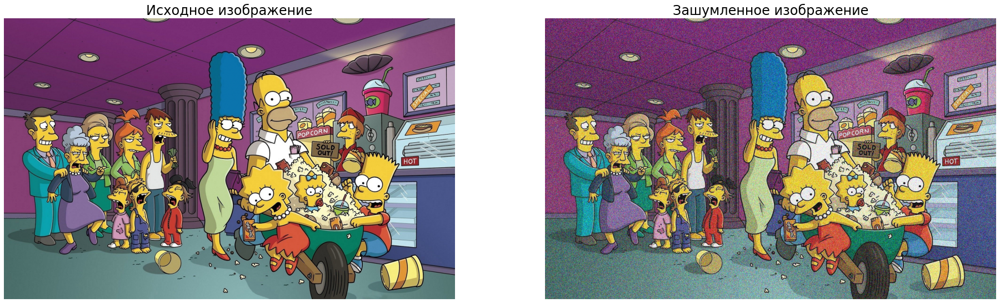

In [316]:
image = cv2.imread('test_image.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) / 255.0

noise_image = image + np.random.normal(loc=0.0, scale=0.2, size=image.shape)
noise_image = np.clip(noise_image, 0.0, 1.0)

# посмотрим на исходное и зашумленное изображение
show_images(image, noise_image, 'Исходное изображение', 'Зашумленное изображение')

In [317]:
# преобразуем зашумленное изображение в тензор
noise_image = K.image_to_tensor(noise_image)

Напишем класс для денойзинга изображений:

In [318]:
class TVDenoise(torch.nn.Module):
    def __init__(self, noise_image):
        super(TVDenoise, self).__init__()
        self.l2 = torch.nn.MSELoss(reduction='mean')
        self.regularization_term = K.losses.TotalVariation()

        # В переменной clean_image хранится изображение, которое будет оптимизироваться
        self.clean_image = torch.nn.Parameter(data=noise_image.clone(), requires_grad=True)
        self.noise_image = noise_image

    def forward(self):
        return self.l2(self.clean_image, self.noise_image) + 0.0001 * self.regularization_term(self.clean_image).mean()

    def get_clean_image(self):
        return self.clean_image

In [319]:
tv_denoiser = TVDenoise(noise_image)

# Задаем оптимайзер, чтобы оптимизировать один параметр (сlean_image)
optimizer = torch.optim.Adam(tv_denoiser.parameters(), lr=0.01)

  0%|          | 0/151 [00:00<?, ?it/s]

Loss in iteration 0 of 151: 97.583


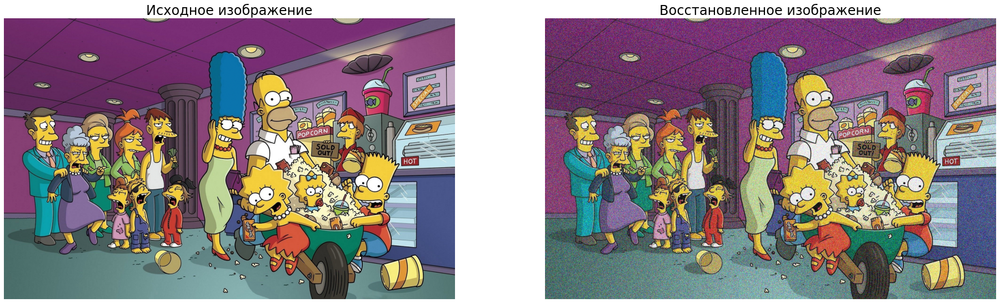

Loss in iteration 30 of 151: 17.559


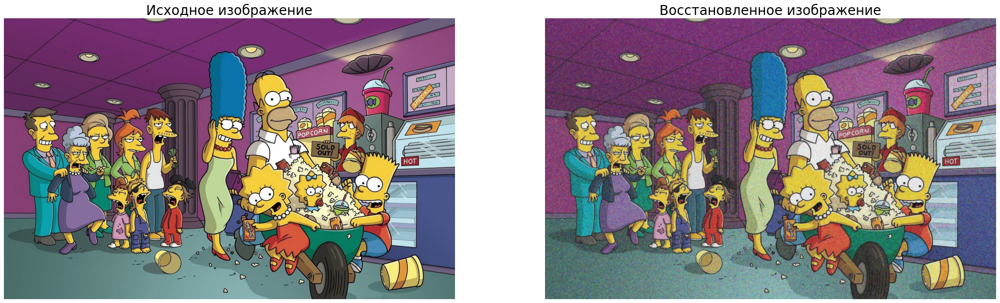

Loss in iteration 60 of 151: 4.951


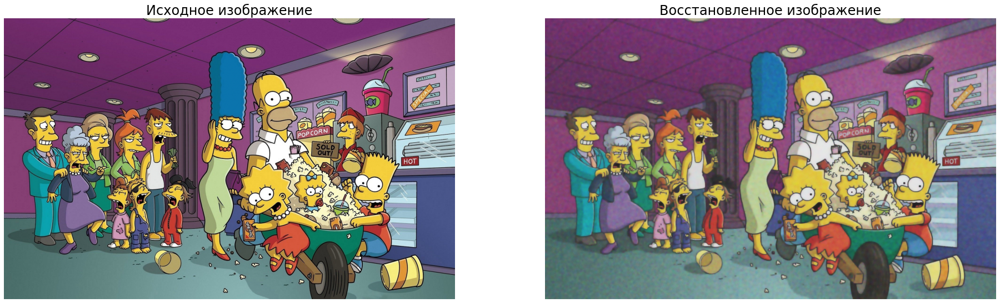

Loss in iteration 90 of 151: 2.658


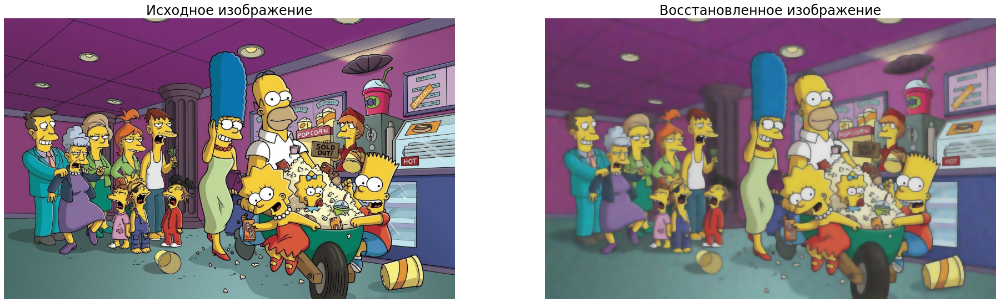

Loss in iteration 120 of 151: 1.971


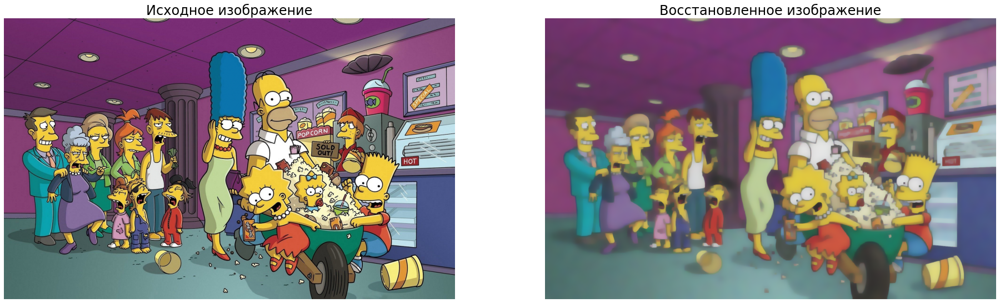

Loss in iteration 150 of 151: 1.654


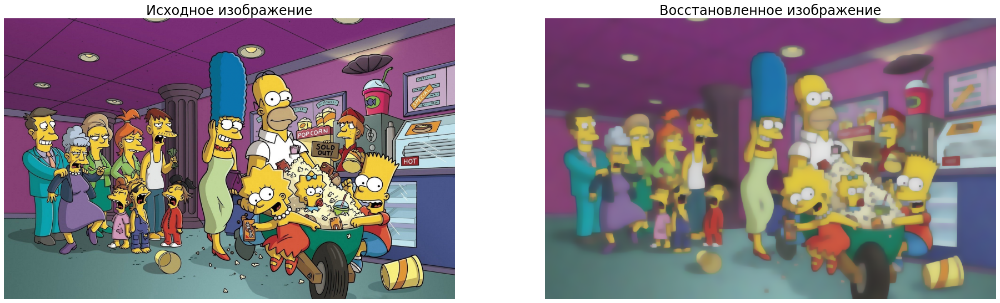

In [320]:
num_iters = 151
for i in tqdm(range(num_iters)):
    optimizer.zero_grad()
    loss = tv_denoiser() 
   
    if i % 30 == 0:
        print("Loss in iteration {} of {}: {:.3f}".format(i, num_iters, loss.item()))
        show_images(image, K.tensor_to_image(tv_denoiser.get_clean_image()), 
                    'Исходное изображение', 'Восстановленное изображение')
    loss.backward()
    optimizer.step()

Видим,что такая процедура денойзинга позволила сгладить цвета, однако мелкие детали на изображении стало сложно отличить из-за TotalVariation-сглаживания.

## 5. Edge Detection с помощью Kornia



In [321]:
image = cv2.imread('test_image.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) / 255.0

image = K.image_to_tensor(image).unsqueeze(0)

In [322]:
# create the operator
canny = K.filters.Canny()

# blur the image
x_magnitude, x_canny = canny(image.float())

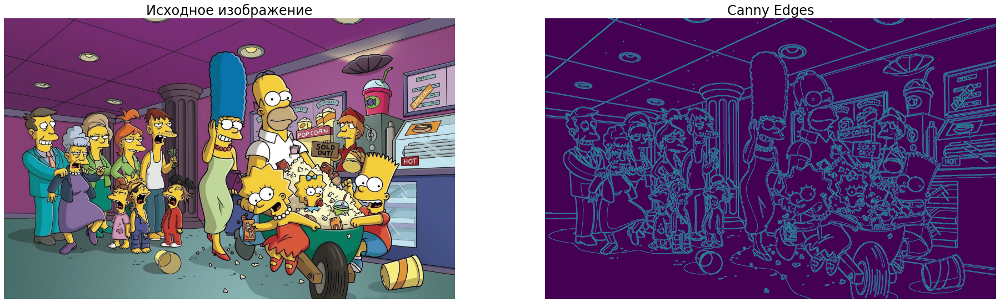

In [323]:
show_images(K.tensor_to_image(image), K.tensor_to_image(x_canny.byte()), 
            'Исходное изображение', 'Canny Edges')

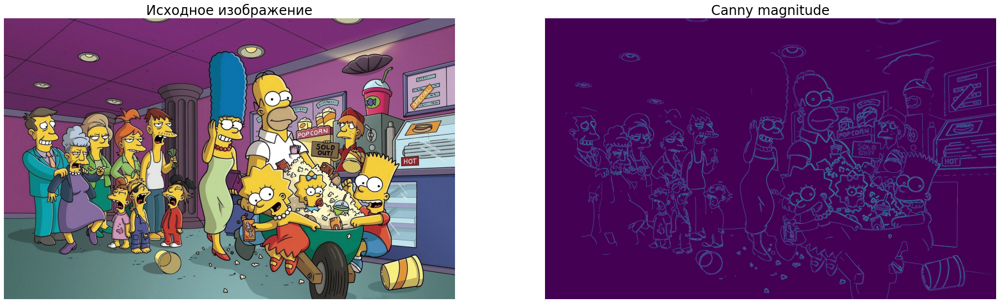

In [324]:
show_images(K.tensor_to_image(image), K.tensor_to_image(x_magnitude.byte()), 
            'Исходное изображение', 'Canny magnitude')

Мы видим, что всего за пару строчек мы смогли сделать Edge Detection с помощью оператора Canny.

## 6. Выводы

В данном jupyter-ноутбуке мы посмотрели на несколько примеров из библиотеки Kornia. Сама библиотека содержит существенно больше интересных опций, поэтому, надеюсь, данный ноутбук послужит стимулом познакомиться с возможностями этой библиотеки более подробно.